In [17]:
include("../modules/IVTmodel.jl")

plotintegralIPFR (generic function with 1 method)

In [2]:
using Pkg
Pkg.activate("../IVTmodel")
Pkg.instantiate()
include("../modules/IVTmodel.jl")
#Generates settings for parameters used
fittingmodel = setupmodel_IVT2()
#Imports calibration data from csv files
modeldata = importakamadata()
#Imports PPiase validation data
PPiasedata = importakamaPPiasedata();
akamafittedparametersmatrix = Matrix(CSV.read("../outputs/fittedparameters.csv", DataFrame,header=false))
akamafittedparameterslist = reshape(akamafittedparametersmatrix,(size(akamafittedparametersmatrix)[1],))
akamafittedcovariancematrix = Matrix(CSV.read("../outputs/covariancematrix.csv", DataFrame,header=false))
akamafittedparams = fullparameterset(fittingmodel,akamafittedparameterslist)
printresidual(fittingmodel,modeldata,akamafittedparameterslist)

  Activating project at `C:\Users\ChemeGrad2021\Documents\Braatz Group\MRNA Synthesis\Published code\IVT2.0\IVTmodel`
Precompiling project...
  ? Metrics
Precompiling Metrics
        Info Given Metrics was explicitly requested, output will be shown live 
ERROR: Method overwriting is not permitted during Module precompilation. Use `__precompile__(false)` to opt-out of precompilation.
  ? Metrics
[ Info: Precompiling Metrics [cb9f3049-315b-4f05-b90c-a8adaec4da78]
ERROR: Method overwriting is not permitted during Module precompilation. Use `__precompile__(false)` to opt-out of precompilation.
[ Info: Skipping precompilation since __precompile__(false). Importing Metrics [cb9f3049-315b-4f05-b90c-a8adaec4da78].
┌ Warning: Replacing docs for `Metrics.bin_to_cat :: Tuple{Any, Any}` in module `Metrics`
└ @ Base.Docs docs\Docs.jl:243
┌ Warning: Replacing docs for `Metrics.confusion_matrix :: Tuple{Any, Any}` in module `Metrics`
└ @ Base.Docs docs\Docs.jl:243
┌ Warning: Replacing docs for `Metri

Model has 14 fitted parameters, 10 of which have a bayesian prior


┌ Warning: Replacing docs for `Metrics.global_stats :: Tuple{Any, Any}` in module `Metrics`
└ @ Base.Docs docs\Docs.jl:243


Total Residual:                        776.7
Components of residual:
Concentration Trajectories (Figure 2): 314.8
Initial Reaction Rate (Figure 3A):     169.2
Mg2PPi solubility (Figure 3B):         214.1
Parameter priors:                      78.6


In [15]:
akamafittedparams

ComponentVector{Float64}(k_dT7 = 0.0, k_i = 8706.203922439476, k_e = 128546.82126027902, k_off = 4320.0, k_on = 204.0, K_1 = 0.0001783376933454784, K_2 = 0.00016783466548935113, Ki_PPi = 3.094906568015022e-5, gamma = 1.0, theta = 0.0208, K_ds = 1.0, kPPiase = 1.0, KMPPiase = 0.000214, k_precip = 3.152096592397201, B = 44.65117781396067, k_d = 44907.88844637152, K_HNTP = 8.128305161640995e6, K_HMgNTP = 120.22644346174131, K_HPPi = 1.0471285480508986e9, K_HMgPPi = 2089.296130854039, K_H2PPi = 1.8197008586099825e6, K_H2MgPPi = 128.82495516931337, K_MgNTP = 16708.101858757498, K_Mg2NTP = 74.70333471203499, K_MgPPi = 214883.98931757538, K_Mg2PPi = 9663.28338245728, Mg2PPi_eq = 0.00012338401553205325, K_MgPi = 158.48931924611142, K_HPi = 8.317637711026709e6, K_NaPi = 5.88843655355589, K_NaNTP = 14.454397707459272)

In [16]:
log10(8.128305161640995e6)

6.91

In [18]:
filename = "../data/arranta/batchrun_5_1/arrantaCOVID_batch_5_1.csv"
labels = ["On-Line Raman", "Offline Nanodrop - 4"]#,"Offline Nanodrop - 5","Offline Nanodrop - 6","Offline Stunner - 7","Offline Stunner - 8"]
arrantaplot2 = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename, range = 5:6,labels = labels,dataerrorbars = true, plotsize = (500,400), multiplot = false)
plot!(dpi = 2000)
savefig(arrantaplot2,"../figures/arrantabatchmeetingfigs/comparing_raman_nanodrop.png")
arrantaplot2

In [20]:
filename = "../data/arranta/batchrun_5_1/arrantaCOVID_batch_5_1.csv"
arrantaplot3 = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename, labels = [""], range = [11],dataerrorbars = true, plotsize = (500,400), multiplot = false,markersize = 0.5)
plot!(dpi = 2000, ylims = (6.5,8))
savefig(arrantaplot3,"../figures/arrantabatchmeetingfigs/fitpH.png")
arrantaplot3

In [256]:
Flucfilename = "../data/arranta/batchrun_5_1/ramandata.csv"
res = (model,data,x) -> customresidualeval(model,data,Flucfilename,x)
optim=localopt(fittingmodel, modeldata,300,akamafittedparameterslist,res,verbose = true)
customfittedparamslist = optim[4]
customfittedparams = fullparameterset(fittingmodel,customfittedparamslist)
customcovariancemat = getcovariancematrix(fittingmodel,modeldata,customfittedparamslist,customfile = true,customfilename = Flucfilename)
writedlm( "../outputs/customfittedparameters.csv",  customfittedparamslist, ',')
writedlm( "../outputs/customcovariancematrix.csv",  customcovariancemat, ',')

25160.351690461135
647302.49589407
14865.90994724247
12547.090201739251
8369.988627141298
8120.145799828911
8060.5398791608795
7933.76918869277
7665.607090281004
7336.508872809041
6822.631299147462
6480.496797472171
6414.002826125918
6399.33896154204
6382.931219128968
6362.086284214949
6306.898648492409
6270.654619105773
6199.936820132669
6130.82414244223
6036.351219079495
5925.403570367276
5858.779073971273
5856.595547948986
5853.6574403983905
5827.930340932154
5824.202591970323
5821.220287202967
5818.162798708367
5814.582441544785
5802.604582306248
5787.889668531262
5785.731541986996
5783.740141392924
5777.045075920803
5768.819673321646
5758.601455906119
5753.310569453858
5751.442618193181
5750.752939896291
5749.936838612197
5747.96727917395
5747.307465561853
5746.421851503628
5738.387121866017
5734.608269145061
5732.61299137953
5730.982453197163
5729.510220443317
5726.5606641109425
5723.314027529414
5714.45924316395
5694.141629565078
5610.6256345707425
6488.012102062094
5576.7674566

LoadError: SingularException(6)

In [262]:
filename = "../data/arranta/batchrun_5_1/ramandata.csv"
arrantaplot2 = plotfromcsv(fittingmodel,customfittedparamslist,akamafittedcovariancematrix,filename,labels = [""], range = 1:1,dataerrorbars = true, plotsize = (500,400), multiplot = false)
plot!(dpi = 2000)
savefig(arrantaplot2,"../figures/arrantabatchmeetingfigs/fittoraman_2.png")
arrantaplot2

In [263]:
filename = "../data/arranta/batchrun_5_1/arrantaCOVID_batch_5_1.csv"
labels = ["ATP","UTP","CTP","GTP"]
arrantaplot2 = plotfromcsv(fittingmodel,customfittedparamslist,akamafittedcovariancematrix,filename,labels = labels, range = 1:4,dataerrorbars = true, plotsize = (500,400), multiplot = false)
plot!(dpi = 2000)
savefig(arrantaplot2,"../figures/arrantabatchmeetingfigs/fitNTPs_2.png")
arrantaplot2

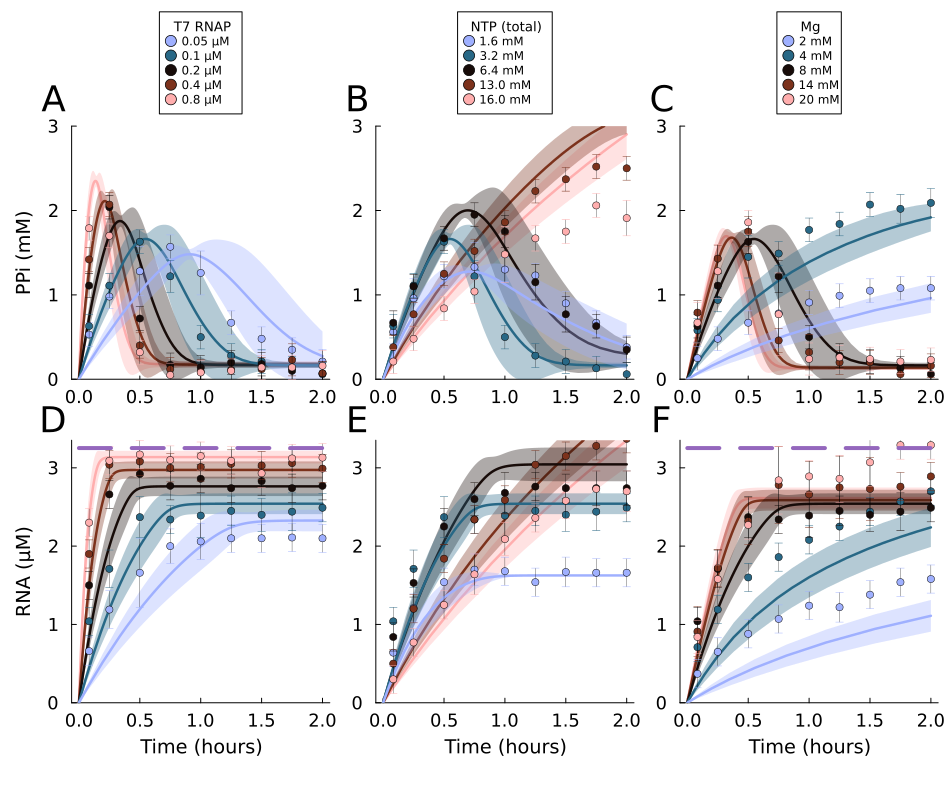

In [264]:
plt = revision1plot1(fittingmodel,modeldata, customfittedparams, akamafittedcovariancematrix, true,true)

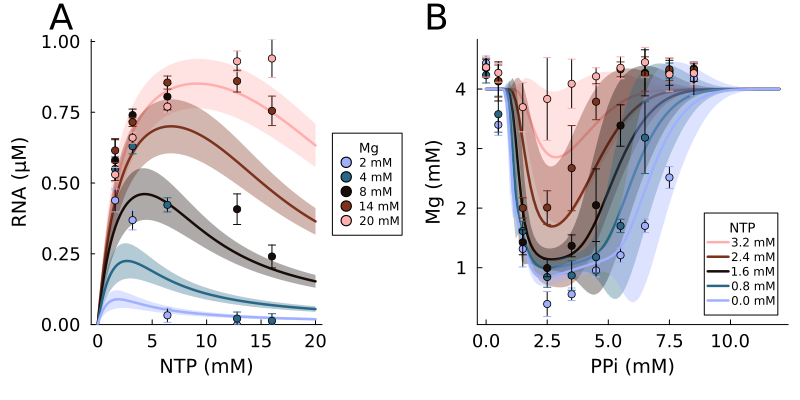

In [265]:
plt = revision1plot2(fittingmodel,modeldata, customfittedparams, akamafittedcovariancematrix, true,true)

In [231]:
#First, we are going to generate a new modeling framework where we fix the fitted akama parameters, and only allow two to vary for fitting: k_e
Flucfittingparameters = [Parameter("k_e",5.3e5,1e3,15e5)]
Flucfittingmodel = fixparameters(fittingmodel,akamafittedparameterslist,resetparameters = Flucfittingparameters)
Flucfilename = "../data/arranta/batchrun_5_1/ramandata.csv"
Flucresidualfunction = (model,_,x) -> customresidual(model, Flucfilename,x)
optim=localopt(Flucfittingmodel,[],300,log10.([2.3e5]),Flucresidualfunction,verbose = true)
Flucfittedparamslist = optim[4]
Flucfittedparams = fullparameterset(Flucfittingmodel,Flucfittedparamslist)
Fluccovariancemat = getcovariancematrix(Flucfittingmodel,[],Flucfittedparamslist,customfile = true,customfilename = Flucfilename, includeakama = false);

63687.577497932754
695954.9190165381
27485.06990764324
695954.9190165381
7414.344024983876
7387.491140075925
5378.224965429591
5341.619436435353
5341.065765802077
5341.065314533782
5341.065315090727
5341.0653145213855
got 5341.0653145213855 at [87773.06021014162] after 12 iterations (returned FTOL_REACHED)


In [ ]:
filename = "../data/arranta/batchrun_5_1/ramandata.csv"
arrantaplot2 = plotfromcsv(Flucfittingmodel,Flucfittedparamslist,Fluccovariancemat,filename,labels = [""], range = 1:1,dataerrorbars = true, plotsize = (500,400), multiplot = false)
plot!(dpi = 2000)
savefig(arrantaplot2,"../figures/arrantabatchmeetingfigs/fittoraman.png")
arrantaplot2

In [208]:
filename = "../data/arranta/batchrun_5_1/ramandata.csv"
arrantaplot2 = plotfromcsv(Flucfittingmodel,Flucfittedparamslist,Fluccovariancemat,filename,labels = [""], range = 1:1,dataerrorbars = true, plotsize = (500,400), multiplot = false)
plot!(dpi = 2000)
savefig(arrantaplot2,"../figures/arrantabatchmeetingfigs/fittoraman.png")
arrantaplot2

In [210]:
filename = "../data/arranta/batchrun_5_1/arrantaCOVID_batch_5_1.csv"
labels = ["ATP","UTP","CTP","GTP"]
arrantaplot2 = plotfromcsv(Flucfittingmodel,Flucfittedparamslist,Fluccovariancemat,filename,labels = labels, range = 1:4,dataerrorbars = true, plotsize = (500,400), multiplot = false)
plot!(dpi = 2000)
savefig(arrantaplot2,"../figures/arrantabatchmeetingfigs/fitNTPs.png")
arrantaplot2

In [268]:
filename = "../data/arranta/batchrun_5_1/arrantaCOVID_batch_5_1.csv"
arrantaplot3 = plotfromcsv(Flucfittingmodel,Flucfittedparamslist,Fluccovariancemat,filename, labels = [""], range = [11],dataerrorbars = true, plotsize = (500,400), multiplot = false,markersize = 0.5)
plot!(dpi = 2000, ylims = (6.5,8))
savefig(arrantaplot3,"../figures/arrantabatchmeetingfigs/fitpH.png")
arrantaplot3

In [1]:
function discreteIVT(t)
    time = [0.03666666666666667, 0.07166666666666666, 0.10833333333333334, 0.145, 0.18166666666666667, 0.21666666666666667, 0.2533333333333333, 0.29, 0.32666666666666666, 0.36166666666666664, 0.3983333333333333, 0.435, 0.4716666666666667, 0.5066666666666666, 0.5433333333333333, 0.58, 0.6166666666666667, 0.6533333333333333, 0.69, 0.725, 0.7616666666666667, 0.7983333333333333, 0.835, 0.87, 0.9066666666666666, 0.9433333333333334, 0.98, 1.0166666666666666, 1.0516666666666667, 1.0883333333333334, 1.125, 1.16, 1.1966666666666665, 1.2333333333333334, 1.27, 1.3066666666666666, 1.3416666666666666, 1.3783333333333334, 1.415, 1.45, 1.4866666666666668, 1.5233333333333334, 1.5599999999999998, 1.5966666666666667, 1.6316666666666668, 1.6683333333333332, 1.7049999999999998, 1.74, 1.7766666666666666, 1.8133333333333332, 1.8499999999999999, 1.8866666666666667, 1.9216666666666666, 1.9583333333333333, 1.995, 2.03, 2.0666666666666664, 2.1033333333333335, 2.14, 2.175, 2.2116666666666664, 2.2483333333333335, 2.2849999999999997, 2.3216666666666668, 2.356666666666667, 2.393333333333333, 2.43, 2.466666666666667, 2.5016666666666665, 2.5383333333333336, 2.575, 2.6116666666666664, 2.646666666666667, 2.683333333333333, 2.7199999999999998, 2.756666666666667, 2.7916666666666665, 2.828333333333333, 2.865, 2.9016666666666664, 2.9366666666666665, 2.9733333333333336, 3.01, 3.046666666666667, 3.0816666666666666, 3.118333333333333, 3.1550000000000002, 3.1916666666666664, 3.2266666666666666]
    RNA = [0.0, 0.66696, 0.77812, 1.1116, 1.44508, 1.55624, 1.77856, 2.55668, 2.66784, 3.2236399999999996, 3.2236399999999996, 3.3348, 3.2236399999999996, 3.77944, 4.22408, 4.55756, 4.4464, 5.11336, 5.224519999999999, 5.44684, 5.44684, 5.8914800000000005, 5.66916, 6.336119999999999, 6.22496, 6.558439999999999, 6.89192, 7.00308, 7.11424, 7.44772, 7.55888, 7.892359999999999, 8.00352, 7.892359999999999, 8.11468, 8.22584, 8.67048, 8.78164, 8.8928, 9.003960000000001, 8.8928, 9.22628, 9.337439999999999, 9.78208, 9.448599999999999, 9.670919999999999, 9.670919999999999, 10.0044, 10.0044, 10.11556, 10.22672, 10.22672, 10.5602, 10.449039999999998, 10.449039999999998, 10.67136, 10.89368, 11.116, 10.89368, 10.78252, 11.22716, 11.22716, 11.33832, 11.22716, 11.116, 11.116, 11.00484, 11.33832, 11.22716, 11.44948, 11.44948, 11.33832, 11.56064, 11.56064, 11.44948, 11.44948, 11.22716, 11.56064, 11.56064, 11.44948, 11.44948, 11.56064, 11.44948, 11.44948, 11.33832, 11.56064, 11.33832, 11.22716, 11.116]
    ATP = [8.0, 7.7544508670520225, 7.693063583815029, 7.447514450867052, 6.772254335260116, 6.956416184971098, 6.710867052023121, 6.772254335260116, 6.649479768786128, 6.281156069364162, 5.790057803468208, 6.096994219653179, 6.342543352601155, 5.912832369942197, 5.851445086705202, 5.360346820809248, 5.544508670520231, 5.176184971098266, 5.176184971098266, 5.176184971098266, 4.8078612716763, 4.685086705202313, 4.7464739884393055, 4.3781502890173405, 4.500924855491329, 4.439537572254335, 4.685086705202313, 4.132601156069364, 4.316763005780347, 4.316763005780347, 4.0098265895953755, 3.9484393063583814, 4.193988439306358, 3.887052023121387, 4.255375722543352, 3.580115606936416, 3.518728323699422, 3.334566473988439, 3.518728323699422, 3.1504046242774564, 3.518728323699422, 3.580115606936416, 3.2117919075144505, 3.027630057803468, 3.2731791907514447, 3.089017341040462, 2.843468208092485, 2.720693641618497, 2.47514450867052, 2.536531791907514, 2.782080924855491, 2.782080924855491, 2.536531791907514, 2.536531791907514, 2.47514450867052, 2.843468208092485, 2.2909826589595372, 2.3523699421965314, 2.4137572254335256, 2.6593063583815026, 2.229595375722543, 2.2909826589595372, 2.229595375722543, 2.168208092485549, 2.168208092485549, 2.1068208092485547, 2.229595375722543, 1.9840462427745662, 2.2909826589595372, 2.04543352601156, 2.4137572254335256, 2.168208092485549, 2.47514450867052, 2.4137572254335256, 1.8612716763005777, 2.229595375722543, 2.2909826589595372, 2.536531791907514, 1.9840462427745662, 2.229595375722543, 2.1068208092485547, 2.229595375722543, 2.04543352601156, 1.7384971098265891, 2.229595375722543, 2.3523699421965314, 2.3523699421965314, 2.3523699421965314, 1.8612716763005777]
    UTP = [8.0, 7.785664739884393, 7.714219653179191, 7.571329479768786, 7.642774566473989, 7.535606936416185, 7.571329479768786, 7.249826589595376, 7.178381502890174, 7.178381502890174, 7.178381502890174, 6.8926011560693645, 6.785433526011561, 6.928323699421965, 6.713988439306359, 6.856878612716763, 6.642543352601156, 6.4996531791907515, 6.4996531791907515, 6.213872832369942, 6.285317919075144, 6.213872832369942, 6.0352601156069365, 6.178150289017341, 5.963815028901734, 5.820924855491329, 5.892369942196532, 5.678034682080924, 5.713757225433525, 5.713757225433525, 5.678034682080924, 5.570867052023122, 5.427976878612717, 5.678034682080924, 5.463699421965318, 5.320809248554913, 5.1779190751445086, 5.285086705202312, 5.070751445086705, 5.1779190751445086, 5.070751445086705, 5.1779190751445086, 5.070751445086705, 5.106473988439307, 5.070751445086705, 4.9278612716763, 4.963583815028902, 4.7849710982658955, 4.9278612716763, 4.749248554913295, 4.749248554913295, 4.677803468208093, 4.570635838150289, 4.677803468208093, 4.713526011560694, 4.7849710982658955, 4.642080924855491, 4.642080924855491, 4.60635838150289, 4.392023121387283, 4.463468208092485, 4.570635838150289, 4.499190751445086, 4.28485549132948, 4.534913294797688, 4.392023121387283, 4.427745664739884, 4.356300578034682, 4.28485549132948, 4.463468208092485, 4.213410404624278, 4.356300578034682, 4.642080924855491, 4.427745664739884, 4.392023121387283, 4.642080924855491, 4.463468208092485, 4.499190751445086, 4.28485549132948, 4.320578034682081, 4.427745664739884, 4.499190751445086, 4.427745664739884, 4.463468208092485, 4.356300578034682, 4.534913294797688, 4.427745664739884, 4.463468208092485, 4.427745664739884]
    CTP = [8.0, 7.84, 7.6, 6.96, 6.72, 6.16, 6.24, 6.48, 5.76, 5.76, 5.28, 5.6, 4.88, 4.88, 5.28, 4.8, 4.0, 3.68, 3.76, 3.6, 4.16, 3.92, 3.36, 4.0, 2.88, 2.8, 2.48, 2.4, 3.36, 1.92, 3.04, 2.24, 2.24, 2.0, 1.92, 2.32, 1.84, 1.52, 1.92, 1.6, 0.96, 1.52, 0.96, 1.52, 1.04, 1.04, 0.32, 0.8, 0.8, 0.64, 0.72, 0.4, 0.64, 0.32, 0.16, 0.4, -0.08, 0.0, -0.08, 0.0, 0.16, 0.16, -0.32, 0.0, -0.48, -0.24, 0.16, -0.32, -0.4, -0.08, -0.24, -0.4, -0.8, -0.32, -0.48, 0.0, 0.24, -0.32, -0.8, 0.16, 0.0, -0.32, -0.24, 0.08, -0.16, -0.24, -0.32, 0.0, 0.0]
    GTP = [8.0, 7.184277456647399, 6.368554913294798, 6.368554913294798, 5.824739884393064, 4.601156069364162, 4.941040462427746, 5.756763005780347, 5.552832369942196, 4.261271676300579, 5.960693641618497, 5.960693641618497, 5.076994219653178, 5.620809248554914, 5.280924855491329, 4.601156069364162, 4.3292485549132955, 4.261271676300579, 5.212947976878612, 4.601156069364162, 4.3292485549132955, 3.17364161849711, 3.3095953757225436, 4.193294797687861, 3.989364161849711, 3.2416184971098265, 3.1056647398843937, 4.057341040462427, 2.4938728323699424, 3.717456647398844, 2.018034682080925, 2.221965317919075, 2.6298265895953756, 2.561849710982659, 2.018034682080925, 2.8337572254335264, 0.8624277456647402, 1.8141040462427749, 1.6781502890173414, 1.4062427745664743, 1.6101734104046246, 3.37757225433526, 1.5421965317919077, 1.202312138728324, 0.7264739884393066, 1.746127167630058, 0.930404624277457, 0.45456647398843963, 1.6101734104046246, -0.22520231213872788, 0.5225433526011564, 0.2506358381502892, 1.9500578034682083, 0.2506358381502892, 0.5225433526011564, 0.31861271676300607, 1.5421965317919077, 0.6584971098265899, 0.8624277456647402, 0.8624277456647402, 0.6584971098265899, 0.31861271676300607, -0.02127167630057758, -0.7010404624277455, 0.7264739884393066, 0.45456647398843963, 0.04670520231213904, -0.02127167630057758, 1.4062427745664743, 0.8624277456647402, 0.5225433526011564, -0.2931791907514447, 0.2506358381502892, 1.0663583815028905, 0.6584971098265899, -0.497109826589595, 0.930404624277457, 1.0663583815028905, 0.2506358381502892, 0.11468208092485588, -0.6330635838150287, -0.7010404624277455, 1.0663583815028905, 0.5225433526011564, 0.8624277456647402, -0.22520231213872788, 0.5225433526011564, 0.9983815028901737, 1.202312138728324]
    GTP = [8.0, 7.184277456647399, 6.368554913294798, 6.368554913294798, 5.824739884393064, 4.601156069364162, 4.941040462427746, 5.756763005780347, 5.552832369942196, 4.261271676300579, 5.960693641618497, 5.960693641618497, 5.076994219653178, 5.620809248554914, 5.280924855491329, 4.601156069364162, 4.3292485549132955, 4.261271676300579, 5.212947976878612, 4.601156069364162, 4.3292485549132955, 3.17364161849711, 3.3095953757225436, 4.193294797687861, 3.989364161849711, 3.2416184971098265, 3.1056647398843937, 4.057341040462427, 2.4938728323699424, 3.717456647398844, 2.018034682080925, 2.221965317919075, 2.6298265895953756, 2.561849710982659, 2.018034682080925, 2.8337572254335264, 0.8624277456647402, 1.8141040462427749, 1.6781502890173414, 1.4062427745664743, 1.6101734104046246, 3.37757225433526, 1.5421965317919077, 1.202312138728324, 0.7264739884393066, 1.746127167630058, 0.930404624277457, 0.45456647398843963, 1.6101734104046246, -0.22520231213872788, 0.5225433526011564, 0.2506358381502892, 1.9500578034682083, 0.2506358381502892, 0.5225433526011564, 0.31861271676300607, 1.5421965317919077, 0.6584971098265899, 0.8624277456647402, 0.8624277456647402, 0.6584971098265899, 0.31861271676300607, -0.02127167630057758, -0.7010404624277455, 0.7264739884393066, 0.45456647398843963, 0.04670520231213904, -0.02127167630057758, 1.4062427745664743, 0.8624277456647402, 0.5225433526011564, -0.2931791907514447, 0.2506358381502892, 1.0663583815028905, 0.6584971098265899, -0.497109826589595, 0.930404624277457, 1.0663583815028905, 0.2506358381502892, 0.11468208092485588, -0.6330635838150287, -0.7010404624277455, 1.0663583815028905, 0.5225433526011564, 0.8624277456647402, -0.22520231213872788, 0.5225433526011564, 0.9983815028901737, 1.202312138728324]
    pHtimes = [0.0, 3.4e-5, 0.002704, 0.006059, 0.009426, 0.012784, 0.016143, 0.019499, 0.022861, 0.026194, 0.029551, 0.032901, 0.036264, 0.039618, 0.039618, 0.042973, 0.042974, 0.046327, 0.049669, 0.053011, 0.056342, 0.059676, 0.063034, 0.066393, 0.06976, 0.073094, 0.07312, 0.076431, 0.079766, 0.083133, 0.086466, 0.089825, 0.091779, 0.093169, 0.096504, 0.099863, 0.103224, 0.106588, 0.109943, 0.113302, 0.116669, 0.120012, 0.123359, 0.126701, 0.126701, 0.130044, 0.130044, 0.13339, 0.13339, 0.136732, 0.140074, 0.143416, 0.143416, 0.146758, 0.150104, 0.153451, 0.156798, 0.160144, 0.16349, 0.166833, 0.166833, 0.170174, 0.173516, 0.176859, 0.180201, 0.183543, 0.18689, 0.190236, 0.193583, 0.193583, 0.196929, 0.200275, 0.203617, 0.206959, 0.206959, 0.210302, 0.213643, 0.21699, 0.220337, 0.223679, 0.223679, 0.22702, 0.230367, 0.233709, 0.237056, 0.240397, 0.24374, 0.247082, 0.250424, 0.25377, 0.257113, 0.260459, 0.260459, 0.263806, 0.267152, 0.270487, 0.270569, 0.27382, 0.27718, 0.280541, 0.283894, 0.287253, 0.29062, 0.293979, 0.29732, 0.297342, 0.299183, 0.300667, 0.300667, 0.304009, 0.30736, 0.310727, 0.314063, 0.317419, 0.320771, 0.324138, 0.327474, 0.330832, 0.334163, 0.337519, 0.340871, 0.340871, 0.344219, 0.344219, 0.347572, 0.350909, 0.354252, 0.357616, 0.36096, 0.364308, 0.364308, 0.367668, 0.367668, 0.371032, 0.371032, 0.374376, 0.37771, 0.377711, 0.38107, 0.38443, 0.387771, 0.391126, 0.394468, 0.397809, 0.401157, 0.404504, 0.407862, 0.411221, 0.411244, 0.414577, 0.417912, 0.421265, 0.424608, 0.427951, 0.431315, 0.434675, 0.434675, 0.436509, 0.438026, 0.441385, 0.444729, 0.444729, 0.448066, 0.448067, 0.451407, 0.451408, 0.454749, 0.454749, 0.458088, 0.461428, 0.461429, 0.464772, 0.464772, 0.468114, 0.468114, 0.471446, 0.471446, 0.474786, 0.474786, 0.478136, 0.478136, 0.481477, 0.481478, 0.484818, 0.484819, 0.488159, 0.488159, 0.491503, 0.491503, 0.494835, 0.498177, 0.498178, 0.501521, 0.501522, 0.50486, 0.50486, 0.5082, 0.511537, 0.511537, 0.514874, 0.514875, 0.518216, 0.518216, 0.521554, 0.521554, 0.524894, 0.524894, 0.528234, 0.531574, 0.531574, 0.534913, 0.534914, 0.538252, 0.538252, 0.541589, 0.544925, 0.54827, 0.551605, 0.554948, 0.554948, 0.558291, 0.558291, 0.561629, 0.564969, 0.568316, 0.571664, 0.571664, 0.575013, 0.575013, 0.578354, 0.581698, 0.585034, 0.588376, 0.591718, 0.591719, 0.595062, 0.598406, 0.598406, 0.601748, 0.605085, 0.608424, 0.611771, 0.611772, 0.615114, 0.618454, 0.618454, 0.621802, 0.621802, 0.625143, 0.628482, 0.631819, 0.631819, 0.635158, 0.6385, 0.6385, 0.641836, 0.641837, 0.645181, 0.648517, 0.648517, 0.651853, 0.655197, 0.655197, 0.658533, 0.658533, 0.66187, 0.66187, 0.665209, 0.668549, 0.668549, 0.671895, 0.675239, 0.67524, 0.678076, 0.678076, 0.678102, 0.678571, 0.681931, 0.681931, 0.685279, 0.688637, 0.691977, 0.691978, 0.695308, 0.695308, 0.698652, 0.698652, 0.701984, 0.701984, 0.70535, 0.708702, 0.712065, 0.715401, 0.715401, 0.718743, 0.718743, 0.722088, 0.722088, 0.725423, 0.728771, 0.732108, 0.735448, 0.735448, 0.738788, 0.742129, 0.745469, 0.745469, 0.748809, 0.748809, 0.752154, 0.755491, 0.758829, 0.762173, 0.762173, 0.765517, 0.765517, 0.768859, 0.772196, 0.775531, 0.775531, 0.778879, 0.77888, 0.782219, 0.782219, 0.785558, 0.785558, 0.788907, 0.788907, 0.792265, 0.792265, 0.795604, 0.798959, 0.798959, 0.80232, 0.80232, 0.805651, 0.805651, 0.809007, 0.809008, 0.812347, 0.815691, 0.815691, 0.819028, 0.82237, 0.825714, 0.829054, 0.832402, 0.835744, 0.839083, 0.842424, 0.842424, 0.845764, 0.849105, 0.849106, 0.852454, 0.855797, 0.859136, 0.86248, 0.865816, 0.865816, 0.869161, 0.869161, 0.872497, 0.872497, 0.875836, 0.879178, 0.879178, 0.882513, 0.88586, 0.889202, 0.892538, 0.895886, 0.899223, 0.902565, 0.902565, 0.905914, 0.909256, 0.909256, 0.912596, 0.912596, 0.915934, 0.915934, 0.919269, 0.922607, 0.922608, 0.925948, 0.929289, 0.929289, 0.932638, 0.93598, 0.939317, 0.939317, 0.942657, 0.942657, 0.945993, 0.945993, 0.949328, 0.95267, 0.956011, 0.959357, 0.962702, 0.962703, 0.966038, 0.96938, 0.96938, 0.972724, 0.97606, 0.979401, 0.982742, 0.986076, 0.986076, 0.989419, 0.989419, 0.992754, 0.992755, 0.996096, 0.999438, 1.002777, 1.002777, 1.006118, 1.009453, 1.012794, 1.016131, 1.016132, 1.019473, 1.019473, 1.022812, 1.022813, 1.026157, 1.029496, 1.032833, 1.036174, 1.039515, 1.039515, 1.042851, 1.046196, 1.049532, 1.052873, 1.052873, 1.056212, 1.056213, 1.059557, 1.059558, 1.062896, 1.062897, 1.066236, 1.069579, 1.069579, 1.072924, 1.076269, 1.079609, 1.07961, 1.082953, 1.086295, 1.086295, 1.089636, 1.092984, 1.096337, 1.09967, 1.103023, 1.103023, 1.106362, 1.106362, 1.109704, 1.109704, 1.113044, 1.116391, 1.119732, 1.119732, 1.123082, 1.126422, 1.126422, 1.129765, 1.129766, 1.133104, 1.136442, 1.139784, 1.143132, 1.146471, 1.149813, 1.153153, 1.153153, 1.156497, 1.159837, 1.163183, 1.163184, 1.16653, 1.169877, 1.169877, 1.173216, 1.176557, 1.179903, 1.179903, 1.183239, 1.18324, 1.186587, 1.186587, 1.189924, 1.189924, 1.193266, 1.196608, 1.199955, 1.203302, 1.203303, 1.206646, 1.206646, 1.209991, 1.213329, 1.216666, 1.220011, 1.223353, 1.223354, 1.22669, 1.226691, 1.230036, 1.233377, 1.236713, 1.236713, 1.240058, 1.240058, 1.243394, 1.243394, 1.246744, 1.246745, 1.250087, 1.250088, 1.253429, 1.25677, 1.260111, 1.263446, 1.266792, 1.270134, 1.273475, 1.276823, 1.279769, 1.279794, 1.28017, 1.280171, 1.283516, 1.283516, 1.286848, 1.286848, 1.290188, 1.293527, 1.293528, 1.29687, 1.296871, 1.300222, 1.303568, 1.306915, 1.310258, 1.310258, 1.313604, 1.316946, 1.320287, 1.32363, 1.326976, 1.330323, 1.333664, 1.333664, 1.337011, 1.337011, 1.340358, 1.340358, 1.343699, 1.347047, 1.350385, 1.353742, 1.357091, 1.360455, 1.360455, 1.363789, 1.36379, 1.364987, 1.364988, 1.365016, 1.365016, 1.367135, 1.370475, 1.373814, 1.377153, 1.377153, 1.380494, 1.380494, 1.383835, 1.383835, 1.387177, 1.387177, 1.390519, 1.393865, 1.393866, 1.397209, 1.400555, 1.400555, 1.4039, 1.403901, 1.407243, 1.410589, 1.410589, 1.413932, 1.417274, 1.420621, 1.423966, 1.423967, 1.427313, 1.430655, 1.433998, 1.437339, 1.440685, 1.444033, 1.444033, 1.447378, 1.450725, 1.454066, 1.457413, 1.457414, 1.460761, 1.460761, 1.464106, 1.464107, 1.467453, 1.467454, 1.470799, 1.474141, 1.474142, 1.477484, 1.480826, 1.480826, 1.484167, 1.487509, 1.487509, 1.490852, 1.490852, 1.494194, 1.497536, 1.500882, 1.504241, 1.507607, 1.510938, 1.514302, 1.517662, 1.52102, 1.524383, 1.527717, 1.531076, 1.534435, 1.5378, 1.541163, 1.544523, 1.547879, 1.551244, 1.554577, 1.557936, 1.5613, 1.564658, 1.567992, 1.571353, 1.574709, 1.578068, 1.581428, 1.584789, 1.588152, 1.59151, 1.594844, 1.598204, 1.601537, 1.604896, 1.608229, 1.611562, 1.614926, 1.618284, 1.621648, 1.625007, 1.628367, 1.631726, 1.635089, 1.638447, 1.641811, 1.64517, 1.648529, 1.651887, 1.655247, 1.658611, 1.66197, 1.665329, 1.668689, 1.672049, 1.675379, 1.678742, 1.682099, 1.685458, 1.688822, 1.692181, 1.695543, 1.698877, 1.702211, 1.705544, 1.708879, 1.712211, 1.715571, 1.718935, 1.722269, 1.725628, 1.728961, 1.73232, 1.735654, 1.739017, 1.742379, 1.745741, 1.749074, 1.752408, 1.755742, 1.759105, 1.762438, 1.765797, 1.76916, 1.772518, 1.775881, 1.779216, 1.782549, 1.785912, 1.789275, 1.792633, 1.795996, 1.799359, 1.802719, 1.806077, 1.809437, 1.812771, 1.816129, 1.819488, 1.822851, 1.826209, 1.829572, 1.832907, 1.836267, 1.839621, 1.842962, 1.842962, 1.846301, 1.846302, 1.849644, 1.853, 1.85636, 1.859719, 1.863048, 1.866411, 1.869774, 1.873137, 1.876496, 1.879856, 1.883215, 1.886566, 1.889194, 1.889219, 1.889907, 1.893273, 1.896632, 1.899963, 1.903328, 1.906691, 1.91005, 1.913409, 1.916772, 1.920136, 1.92347, 1.926803, 1.930137, 1.9335, 1.936834, 1.940169, 1.943503, 1.946861, 1.950221, 1.953584, 1.956918, 1.960252, 1.963614, 1.966978, 1.970337, 1.973696, 1.97705, 1.980388, 1.983721, 1.987081, 1.990414, 1.993774, 1.997107, 2.00045, 2.003796, 2.007156, 2.010519, 2.013853, 2.017212, 2.020567, 2.023924, 2.02729, 2.030644, 2.034007, 2.03737, 2.040733, 2.044093, 2.047448, 2.050811, 2.05414, 2.057503, 2.060862, 2.064226, 2.067585, 2.070944, 2.074302, 2.077657, 2.081026, 2.084384, 2.087748, 2.091106, 2.094469, 2.097802, 2.101136, 2.104467, 2.107831, 2.111189, 2.114523, 2.117852, 2.121191, 2.124546, 2.127909, 2.131267, 2.134628, 2.13799, 2.141339, 2.144699, 2.148051, 2.151387, 2.15474, 2.158104, 2.161454, 2.164818, 2.168148, 2.171511, 2.174841, 2.178204, 2.181533, 2.184871, 2.188205, 2.191564, 2.194897, 2.198256, 2.201589, 2.204924, 2.208283, 2.211612, 2.214975, 2.218338, 2.221693, 2.225057, 2.228413, 2.231776, 2.235133, 2.238496, 2.241852, 2.24521, 2.248574, 2.251929, 2.255267, 2.258622, 2.26199, 2.265348, 2.268711, 2.272067, 2.275427, 2.278791, 2.282146, 2.285512, 2.288867, 2.29223, 2.295588, 2.298951, 2.302315, 2.305669, 2.309033, 2.312362, 2.315726, 2.319085, 2.322423, 2.325753, 2.329118, 2.332446, 2.33581, 2.339164, 2.342503, 2.345858, 2.349226, 2.352555, 2.355922, 2.359278, 2.362637, 2.365996, 2.369356, 2.37272, 2.376074, 2.379412, 2.382742, 2.386105, 2.389435, 2.392799, 2.396154, 2.399517, 2.402846, 2.406217, 2.409572, 2.412935, 2.416291, 2.419652, 2.423015, 2.426369, 2.42974, 2.433095, 2.436453, 2.439787, 2.443146, 2.446479, 2.449846, 2.453201, 2.45656, 2.459919, 2.463252, 2.466615, 2.469978, 2.473341, 2.476695, 2.480058, 2.483417, 2.486776, 2.490135, 2.493502, 2.496836, 2.500194, 2.503548, 2.50691, 2.510248, 2.513602, 2.516965, 2.520319, 2.523659, 2.526995, 2.526995, 2.530343, 2.530343, 2.533679, 2.537027, 2.537028, 2.540363, 2.543706, 2.547048, 2.550395, 2.55374, 2.553741, 2.557083, 2.560425, 2.560425, 2.563766, 2.567109, 2.56711, 2.57045, 2.573798, 2.577139, 2.580492, 2.583828, 2.58717, 2.590511, 2.593854, 2.597196, 2.597196, 2.600544, 2.603885, 2.607232, 2.610577, 2.613919, 2.617262, 2.620604, 2.62395, 2.627293, 2.630634, 2.633981, 2.637328, 2.637328, 2.64067, 2.644014, 2.647353, 2.647353, 2.650696, 2.654037, 2.654037, 2.657381, 2.660722, 2.664068, 2.667411, 2.670752, 2.670752, 2.674094, 2.677436, 2.677437, 2.680783, 2.684129, 2.687472, 2.690814, 2.694155, 2.694155, 2.697502, 2.700844, 2.704191, 2.707537, 2.71088, 2.71088, 2.714221, 2.714221, 2.717568, 2.720914, 2.724261, 2.727607, 2.73095, 2.734296, 2.737638, 2.74098, 2.744322, 2.747664, 2.751005, 2.754348, 2.757693, 2.757693, 2.761037, 2.761037, 2.764383, 2.767725, 2.771067, 2.774409, 2.777756, 2.777756, 2.781098, 2.784444, 2.787791, 2.791132, 2.794475, 2.797817, 2.801159, 2.804501, 2.807844, 2.81119, 2.814534, 2.817889, 2.821247, 2.824614, 2.827973, 2.831333, 2.834693, 2.838053, 2.841411, 2.844778, 2.848134, 2.851502, 2.854831, 2.858165, 2.861532, 2.864891, 2.868249, 2.871617, 2.87495, 2.878309, 2.881674, 2.885004, 2.888371, 2.891702, 2.895062, 2.898422, 2.901783, 2.905142, 2.908501, 2.911861, 2.91522, 2.918553, 2.921887, 2.925246, 2.928613, 2.931947, 2.93528, 2.938639, 2.941998, 2.945357, 2.948716, 2.95205, 2.95541, 2.958768, 2.962136, 2.965467, 2.968826, 2.972186, 2.975546, 2.978914, 2.982244, 2.985603, 2.988966, 2.992329, 2.995688, 2.999048, 3.002407, 3.005767, 3.009126, 3.012461, 3.015819, 3.019184, 3.022516, 3.025884, 3.029218, 3.032576, 3.035935, 3.039294, 3.042654, 3.046017, 3.04938, 3.052711, 3.056045, 3.059406, 3.06277, 3.066128, 3.069491, 3.07285, 3.076209, 3.07623, 3.079567, 3.082934, 3.086268, 3.089627, 3.092991, 3.096325, 3.099655, 3.103023, 3.106352, 3.109719, 3.113078, 3.115034, 3.11506, 3.116422, 3.119781, 3.12314, 3.126499, 3.129858, 3.133221, 3.136579, 3.139938, 3.143301, 3.146664, 3.149998, 3.153331, 3.15669, 3.160049, 3.163408, 3.166771, 3.170101, 3.173461, 3.176823, 3.180154, 3.183517, 3.186879, 3.190213, 3.193544, 3.196903, 3.200237, 3.2036, 3.206933, 3.210296, 3.213655, 3.217014, 3.220377, 3.223707, 3.22707, 3.230433, 3.232406, 3.232697, 3.232974, 3.233253, 3.233292]
    pH = [6.967000008, 6.967000008, 7.012000084, 7.059999943, 6.926000118, 7.019999981, 6.986000061, 7.026000023, 7.103000164, 6.965000153, 6.919000149, 6.948999882, 6.910999775, 6.910999775, 7.008999825, 7.008999825, 6.993999958, 6.921999931, 6.921000004, 6.867000103, 6.97300005, 6.981999874, 6.916999817, 6.981999874, 6.914999962, 6.997000217, 6.997000217, 6.987999916, 6.940999985, 6.90899992, 6.902999878, 6.914999962, 6.914999962, 6.955999851, 6.920000076, 6.948999882, 6.929999828, 6.916999817, 6.93900013, 6.93200016, 6.857999802, 6.914999962, 6.903999805, 6.903999805, 6.93200016, 6.93200016, 6.887000084, 6.887000084, 6.888000011, 6.888000011, 6.836999893, 6.836999893, 6.864999771, 6.834000111, 6.90199995, 6.876999855, 6.926000118, 6.903999805, 6.881999969, 6.881999969, 6.861000061, 6.835000038, 6.866000175, 6.861999989, 6.881999969, 6.835999966, 6.859000206, 6.852000237, 6.852000237, 6.840000153, 6.855999947, 6.861000061, 6.863999844, 6.863999844, 6.850999832, 6.847000122, 6.912000179, 6.824999809, 6.892000198, 6.892000198, 6.914000034, 6.900000095, 6.910999775, 6.931000233, 6.888000011, 6.889999866, 6.902999878, 6.882999897, 6.895999908, 6.912000179, 6.90500021, 6.90500021, 6.909999847, 6.896999836, 6.876999855, 6.876999855, 6.894999981, 6.874000072, 6.880000114, 6.809000015, 6.861999989, 6.827000141, 6.860000134, 6.84800005, 6.885000229, 6.885000229, 6.885000229, 6.885000229, 6.839000225, 6.839000225, 6.822999954, 6.861999989, 6.842000008, 6.84800005, 6.827000141, 6.828999996, 6.874000072, 6.866000175, 6.843999863, 6.849999905, 6.849999905, 6.881999969, 6.881999969, 6.775000095, 6.837999821, 6.84800005, 6.815999985, 6.822999954, 6.849999905, 6.849999905, 6.78399992, 6.78399992, 6.84100008, 6.84100008, 6.856999874, 6.846000195, 6.846000195, 6.868000031, 6.820000172, 6.876999855, 6.801000118, 6.831999779, 6.757999897, 6.84800005, 6.816999912, 6.788000107, 6.815999985, 6.80700016, 6.80700016, 6.785999775, 6.816999912, 6.864999771, 6.843999863, 6.787000179, 6.793000221, 6.793000221, 6.789000034, 6.789000034, 6.785999775, 6.861000061, 6.861000061, 6.81400013, 6.81400013, 6.855999947, 6.855999947, 6.816999912, 6.816999912, 6.839000225, 6.788000107, 6.788000107, 6.84499979, 6.84499979, 6.842999935, 6.842999935, 6.856999874, 6.856999874, 6.797999859, 6.797999859, 6.782999992, 6.782999992, 6.806000233, 6.806000233, 6.850999832, 6.850999832, 6.847000122, 6.847000122, 6.830999851, 6.830999851, 6.864999771, 6.816999912, 6.816999912, 6.896999836, 6.896999836, 6.809000015, 6.809000015, 6.816999912, 6.721000195, 6.721000195, 6.785999775, 6.785999775, 6.803999901, 6.803999901, 6.822999954, 6.822999954, 6.809999943, 6.809999943, 6.785999775, 6.768000126, 6.768000126, 6.802000046, 6.802000046, 6.757999897, 6.757999897, 6.808000088, 6.765999794, 6.789999962, 6.820000172, 6.804999828, 6.804999828, 6.763999939, 6.763999939, 6.831999779, 6.854000092, 6.843999863, 6.840000153, 6.840000153, 6.778999805, 6.778999805, 6.78000021, 6.741000175, 6.790999889, 6.770999908, 6.821000099, 6.821000099, 6.802000046, 6.811999798, 6.811999798, 6.78000021, 6.771999836, 6.777999878, 6.788000107, 6.788000107, 6.735000134, 6.784999847, 6.784999847, 6.704999924, 6.704999924, 6.787000179, 6.791999817, 6.765999794, 6.765999794, 6.736000061, 6.71600008, 6.71600008, 6.784999847, 6.784999847, 6.785999775, 6.737999916, 6.737999916, 6.822999954, 6.856999874, 6.856999874, 6.769000053, 6.769000053, 6.745999813, 6.745999813, 6.747000217, 6.758999825, 6.758999825, 6.787000179, 6.777999878, 6.777999878, 6.768000126, 6.768000126, 6.761000156, 6.761000156, 6.741000175, 6.741000175, 6.78399992, 6.800000191, 6.762000084, 6.762000084, 6.782999992, 6.782999992, 6.78399992, 6.78399992, 6.761000156, 6.761000156, 6.789000034, 6.782999992, 6.769000053, 6.782000065, 6.782000065, 6.78399992, 6.78399992, 6.782000065, 6.782000065, 6.789000034, 6.808000088, 6.754000187, 6.747000217, 6.747000217, 6.771999836, 6.77699995, 6.743999958, 6.743999958, 6.788000107, 6.788000107, 6.790999889, 6.796000004, 6.787000179, 6.793000221, 6.793000221, 6.75, 6.75, 6.785999775, 6.756000042, 6.739999771, 6.739999771, 6.788000107, 6.788000107, 6.747000217, 6.747000217, 6.78000021, 6.78000021, 6.77699995, 6.77699995, 6.712999821, 6.712999821, 6.777999878, 6.752999783, 6.752999783, 6.697999954, 6.697999954, 6.790999889, 6.790999889, 6.721000195, 6.721000195, 6.756000042, 6.669000149, 6.669000149, 6.741000175, 6.836999893, 6.784999847, 6.749000072, 6.769000053, 6.78000021, 6.767000198, 6.737999916, 6.737999916, 6.787000179, 6.741000175, 6.741000175, 6.747000217, 6.756000042, 6.769999981, 6.787000179, 6.809000015, 6.809000015, 6.758999825, 6.758999825, 6.704999924, 6.704999924, 6.782000065, 6.730999947, 6.730999947, 6.789000034, 6.757999897, 6.705999851, 6.711999893, 6.777999878, 6.757999897, 6.717999935, 6.717999935, 6.769000053, 6.672999859, 6.672999859, 6.691999912, 6.691999912, 6.710000038, 6.710000038, 6.691999912, 6.72300005, 6.72300005, 6.730000019, 6.772999763, 6.772999763, 6.701000214, 6.714000225, 6.708000183, 6.708000183, 6.728000164, 6.728000164, 6.697999954, 6.697999954, 6.717999935, 6.78000021, 6.710999966, 6.754000187, 6.755000114, 6.755000114, 6.762000084, 6.717999935, 6.717999935, 6.729000092, 6.714000225, 6.762000084, 6.725999832, 6.735000134, 6.735000134, 6.743000031, 6.743000031, 6.703999996, 6.703999996, 6.738999844, 6.756000042, 6.727000237, 6.727000237, 6.712999821, 6.703999996, 6.724999905, 6.736999989, 6.736999989, 6.71999979, 6.71999979, 6.677999973, 6.677999973, 6.69299984, 6.686999798, 6.730000019, 6.704999924, 6.723999977, 6.723999977, 6.691999912, 6.725999832, 6.715000153, 6.739999771, 6.739999771, 6.71600008, 6.71600008, 6.631999969, 6.631999969, 6.666999817, 6.666999817, 6.705999851, 6.670000076, 6.670000076, 6.68900013, 6.649000168, 6.681000233, 6.681000233, 6.686999798, 6.665999889, 6.665999889, 6.690999985, 6.701000214, 6.622000217, 6.671999931, 6.669000149, 6.669000149, 6.728000164, 6.728000164, 6.691999912, 6.691999912, 6.691999912, 6.675000191, 6.688000202, 6.688000202, 6.637000084, 6.672999859, 6.672999859, 6.643000126, 6.643000126, 6.715000153, 6.708000183, 6.698999882, 6.756000042, 6.697000027, 6.714000225, 6.695000172, 6.695000172, 6.747000217, 6.676000118, 6.688000202, 6.688000202, 6.635000229, 6.68599987, 6.68599987, 6.679999828, 6.635000229, 6.729000092, 6.729000092, 6.651000023, 6.651000023, 6.650000095, 6.650000095, 6.69299984, 6.69299984, 6.656000137, 6.712999821, 6.686999798, 6.681000233, 6.681000233, 6.717000008, 6.717000008, 6.706999779, 6.697999954, 6.677000046, 6.647999763, 6.671000004, 6.671000004, 6.678999901, 6.678999901, 6.701000214, 6.693999767, 6.702000141, 6.702000141, 6.710999966, 6.710999966, 6.698999882, 6.698999882, 6.693999767, 6.693999767, 6.704999924, 6.704999924, 6.691999912, 6.690999985, 6.697999954, 6.725999832, 6.656000137, 6.703999996, 6.703000069, 6.649000168, 6.727000237, 6.671000004, 6.671000004, 6.671000004, 6.68200016, 6.68200016, 6.656000137, 6.656000137, 6.678999901, 6.665999889, 6.665999889, 6.657000065, 6.657000065, 6.638999939, 6.644000053, 6.68200016, 6.649000168, 6.649000168, 6.677999973, 6.620999813, 6.614999771, 6.620999813, 6.676000118, 6.623000145, 6.684999943, 6.684999943, 6.704999924, 6.704999924, 6.683000088, 6.683000088, 6.697999954, 6.679999828, 6.748000145, 6.662000179, 6.666999817, 6.688000202, 6.688000202, 6.671999931, 6.671999931, 6.620999813, 6.620999813, 6.630000114, 6.630000114, 6.630000114, 6.676000118, 6.702000141, 6.684999943, 6.684999943, 6.695000172, 6.695000172, 6.68200016, 6.68200016, 6.671000004, 6.671000004, 6.663000107, 6.652999878, 6.652999878, 6.663000107, 6.664000034, 6.664000034, 6.686999798, 6.686999798, 6.676000118, 6.642000198, 6.642000198, 6.686999798, 6.638000011, 6.631000042, 6.625999928, 6.625999928, 6.644000053, 6.631000042, 6.643000126, 6.573999882, 6.662000179, 6.636000156, 6.636000156, 6.614999771, 6.565999985, 6.631999969, 6.693999767, 6.693999767, 6.623000145, 6.623000145, 6.643000126, 6.643000126, 6.684999943, 6.684999943, 6.652999878, 6.65199995, 6.65199995, 6.69299984, 6.679999828, 6.679999828, 6.684999943, 6.633999825, 6.633999825, 6.622000217, 6.622000217, 6.657999992, 6.665999889, 6.612999916, 6.664999962, 6.65199995, 6.645999908, 6.617000103, 6.645999908, 6.645999908, 6.653999805, 6.686999798, 6.626999855, 6.649000168, 6.638999939, 6.683000088, 6.664000034, 6.650000095, 6.600999832, 6.657000065, 6.671000004, 6.626999855, 6.668000221, 6.625999928, 6.653999805, 6.721000195, 6.664000034, 6.631999969, 6.659999847, 6.638999939, 6.616000175, 6.651000023, 6.605999947, 6.622000217, 6.598999977, 6.56799984, 6.578000069, 6.618999958, 6.626999855, 6.585000038, 6.570000172, 6.619999886, 6.606999874, 6.611999989, 6.660999775, 6.630000114, 6.637000084, 6.607999802, 6.643000126, 6.604000092, 6.657999992, 6.639999866, 6.65199995, 6.659999847, 6.65199995, 6.660999775, 6.599999905, 6.636000156, 6.678999901, 6.586999893, 6.625, 6.656000137, 6.643000126, 6.664000034, 6.579999924, 6.617000103, 6.666999817, 6.639999866, 6.585999966, 6.592000008, 6.578000069, 6.611999989, 6.614999771, 6.611999989, 6.611999989, 6.611999989, 6.619999886, 6.635000229, 6.651000023, 6.631999969, 6.626999855, 6.653999805, 6.679999828, 6.624000072, 6.605999947, 6.584000111, 6.664999962, 6.622000217, 6.611999989, 6.650000095, 6.600999832, 6.59100008, 6.650000095, 6.585999966, 6.596000195, 6.638999939, 6.603000164, 6.578000069, 6.596000195, 6.627999783, 6.617000103, 6.625999928, 6.600999832, 6.616000175, 6.550000191, 6.627999783, 6.627999783, 6.602000237, 6.602000237, 6.59499979, 6.597000122, 6.644999981, 6.622000217, 6.583000183, 6.605000019, 6.649000168, 6.673999786, 6.612999916, 6.65899992, 6.665999889, 6.617000103, 6.578999996, 6.633999825, 6.633999825, 6.59800005, 6.606999874, 6.611000061, 6.646999836, 6.632999897, 6.637000084, 6.653999805, 6.611000061, 6.559999943, 6.620999813, 6.600999832, 6.627999783, 6.599999905, 6.580999851, 6.59100008, 6.623000145, 6.532999992, 6.586999893, 6.543000221, 6.572999954, 6.596000195, 6.545000076, 6.617000103, 6.668000221, 6.583000183, 6.618000031, 6.616000175, 6.645999908, 6.602000237, 6.657999992, 6.597000122, 6.59800005, 6.65500021, 6.611000061, 6.606999874, 6.620999813, 6.546000004, 6.596000195, 6.636000156, 6.592999935, 6.566999912, 6.561999798, 6.59499979, 6.578000069, 6.618999958, 6.578000069, 6.609000206, 6.625999928, 6.600999832, 6.585999966, 6.613999844, 6.610000134, 6.592000008, 6.637000084, 6.56099987, 6.613999844, 6.585999966, 6.572999954, 6.59800005, 6.626999855, 6.627999783, 6.613999844, 6.612999916, 6.592000008, 6.631999969, 6.593999863, 6.611999989, 6.633999825, 6.645999908, 6.617000103, 6.642000198, 6.619999886, 6.590000153, 6.579999924, 6.573999882, 6.602000237, 6.597000122, 6.59499979, 6.583000183, 6.585999966, 6.592000008, 6.603000164, 6.637000084, 6.599999905, 6.553999901, 6.607999802, 6.631999969, 6.535999775, 6.565999985, 6.585999966, 6.590000153, 6.596000195, 6.586999893, 6.592999935, 6.572999954, 6.574999809, 6.590000153, 6.563000202, 6.610000134, 6.580999851, 6.526000023, 6.59499979, 6.610000134, 6.619999886, 6.603000164, 6.585000038, 6.586999893, 6.563000202, 6.65199995, 6.581999779, 6.599999905, 6.593999863, 6.59800005, 6.605000019, 6.577000141, 6.511000156, 6.586999893, 6.596000195, 6.59499979, 6.603000164, 6.611999989, 6.584000111, 6.59800005, 6.59100008, 6.598999977, 6.611999989, 6.605000019, 6.592999935, 6.587999821, 6.554999828, 6.550000191, 6.576000214, 6.573999882, 6.622000217, 6.583000183, 6.580999851, 6.581999779, 6.577000141, 6.550000191, 6.572999954, 6.593999863, 6.556000233, 6.600999832, 6.603000164, 6.604000092, 6.604000092, 6.585000038, 6.592000008, 6.586999893, 6.596000195, 6.611000061, 6.59800005, 6.585000038, 6.596000195, 6.605999947, 6.587999821, 6.565000057, 6.609000206, 6.596000195, 6.599999905, 6.614999771, 6.584000111, 6.56400013, 6.573999882, 6.56799984, 6.561999798, 6.614999771, 6.573999882, 6.56099987, 6.537000179, 6.565000057, 6.585999966, 6.578000069, 6.553999901, 6.571000099, 6.56099987, 6.566999912, 6.583000183, 6.590000153, 6.610000134, 6.590000153, 6.578999996, 6.589000225, 6.587999821, 6.605999947, 6.585000038, 6.590000153, 6.604000092, 6.579999924, 6.585999966, 6.585999966, 6.568999767, 6.568999767, 6.579999924, 6.578000069, 6.578000069, 6.598999977, 6.596000195, 6.593999863, 6.584000111, 6.570000172, 6.570000172, 6.568999767, 6.583000183, 6.583000183, 6.579999924, 6.561999798, 6.561999798, 6.579999924, 6.605000019, 6.583000183, 6.597000122, 6.579999924, 6.59100008, 6.552000046, 6.56400013, 6.563000202, 6.563000202, 6.578000069, 6.539999962, 6.568999767, 6.570000172, 6.59499979, 6.578999996, 6.593999863, 6.573999882, 6.578999996, 6.580999851, 6.579999924, 6.578999996, 6.578999996, 6.600999832, 6.570000172, 6.593999863, 6.593999863, 6.584000111, 6.565999985, 6.565999985, 6.59499979, 6.597000122, 6.585999966, 6.578999996, 6.566999912, 6.566999912, 6.578999996, 6.605000019, 6.605000019, 6.580999851, 6.598999977, 6.596000195, 6.598999977, 6.590000153, 6.590000153, 6.578999996, 6.572999954, 6.576000214, 6.566999912, 6.587999821, 6.587999821, 6.559000015, 6.559000015, 6.585999966, 6.576000214, 6.573999882, 6.572999954, 6.586999893, 6.605999947, 6.572999954, 6.586999893, 6.592999935, 6.565000057, 6.574999809, 6.565000057, 6.570000172, 6.570000172, 6.56099987, 6.56099987, 6.576000214, 6.566999912, 6.577000141, 6.581999779, 6.590000153, 6.590000153, 6.573999882, 6.553999901, 6.578000069, 6.580999851, 6.598999977, 6.56799984, 6.586999893, 6.573999882, 6.605000019, 6.586999893, 6.605999947, 6.606999874, 6.584000111, 6.574999809, 6.570000172, 6.580999851, 6.570000172, 6.578000069, 6.558000088, 6.56099987, 6.617000103, 6.552000046, 6.59100008, 6.574999809, 6.577000141, 6.589000225, 6.589000225, 6.585999966, 6.584000111, 6.56799984, 6.602000237, 6.589000225, 6.578000069, 6.598999977, 6.592999935, 6.599999905, 6.573999882, 6.574999809, 6.565999985, 6.565000057, 6.587999821, 6.607999802, 6.579999924, 6.581999779, 6.565999985, 6.55700016, 6.585000038, 6.576000214, 6.585000038, 6.593999863, 6.592000008, 6.587999821, 6.556000233, 6.572999954, 6.56099987, 6.596000195, 6.576000214, 6.589000225, 6.583000183, 6.559999943, 6.599999905, 6.586999893, 6.586999893, 6.598999977, 6.586999893, 6.552000046, 6.53000021, 6.585999966, 6.572999954, 6.578999996, 6.586999893, 6.587999821, 6.581999779, 6.584000111, 6.574999809, 6.572999954, 6.559999943, 6.573999882, 6.611000061, 6.578000069, 6.568999767, 6.586999893, 6.592999935, 6.578000069, 6.556000233, 6.559000015, 6.585000038, 6.570000172, 6.571000099, 6.578000069, 6.578000069, 6.553999901, 6.563000202, 6.583000183, 6.603000164, 6.586999893, 6.572999954, 6.551000118, 6.559000015, 6.574999809, 6.592999935, 6.587999821, 6.565999985, 6.565999985, 6.585999966, 6.597000122, 6.580999851, 6.585999966, 6.572999954, 6.572000027, 6.576000214, 6.558000088, 6.578999996, 6.602000237, 6.583000183, 6.565999985, 6.565000057, 6.563000202, 6.565999985, 6.577000141, 6.559999943, 6.593999863, 6.568999767, 6.597000122, 6.546999931, 6.56099987, 6.589000225, 6.56400013, 6.577000141, 6.568999767, 6.55700016, 6.585999966, 6.596000195, 6.584000111, 6.56799984, 6.559000015, 6.559000015, 6.572000027, 6.597000122, 6.597000122, 6.572000027, 6.565999985, 6.581999779, 6.581999779]
    IVTdata = hcat(RNA,ATP,UTP,CTP,GTP)
    return [IVTdata[sum(time .< t)+1,:]...,pH[sum(pHtimes .< t)+1]]
end

discreteIVT (generic function with 1 method)

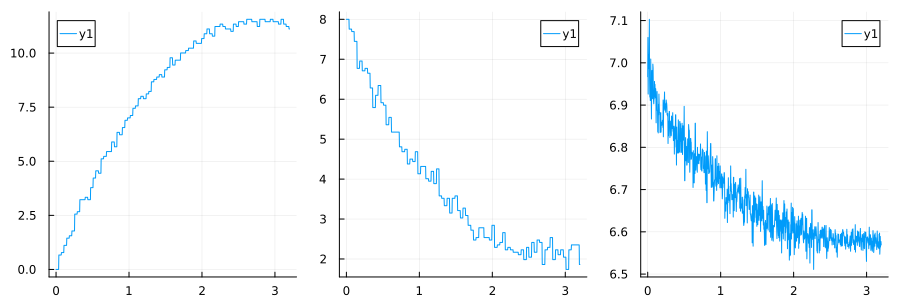

In [36]:
ts = LinRange(0,3.2,1000)
RNAvalues = [discreteIVT(t)[1] for t in ts]
ATPvalues = [discreteIVT(t)[2] for t in ts]
pHvalues = [discreteIVT(t)[end] for t in ts]

plt1 = plot(ts,RNAvalues)
plt2 = plot(ts,ATPvalues)
plt3 = plot(ts,pHvalues)
plot(plt1,plt2,plt3,layout = (1,3), size = (900,300))

In [224]:
L1 = 8e-4
alpha = 10
L2 = 0.0
N_all = 2117

plt1 = plot(label = "Sensor Data",ylabel = "Total RNA (μM)",xlabel = "Time (h)",legend = :outerbottom)
plt2 = plot(label = "",legend = :outerbottom,ylabel = "ATP (mM)",xlabel = "Time (h)")
plt3 = plot(label = "",legend = :outerbottom,ylabel = "pH",xlabel = "Time (h)")

inputs = (T7RNAP = 240e-9, ATP = 8e-3,UTP = 8e-3,CTP = 8e-3,GTP = 8e-3, Mg = 26e-3, Buffer = 0.040, DNA = 19.442, final_time = 3.2)
PPiase = 0.02
Cap = 4e-3
stoich = (531,309,692,588)

sol = runobservedbatch(Flucfittedparams, inputs,[0.0,0.0,0.0,0.0],discreteIVT,PPiase = PPiase, stoich = stoich)
plot!(plt1,sol[2].t,totalrna(sol,0),linewidth = 3, label = "Model - No observer")
plot!(plt2,sol[2].t,atp(sol,0),linewidth = 3, label = "Model - No observer")
plot!(plt3,sol[2].t,ph(sol,0),linewidth = 3, label = "Model - No observer")

sol = runobservedbatch(Flucfittedparams, inputs,[0.1*alpha*L1/1000,0.0,0.1*L2,0.1*L1],discreteIVT,PPiase = PPiase, stoich = stoich)
plot!(plt1,sol[2].t,totalrna(sol,0),linewidth = 3, label = "Model - Weak tuning")
plot!(plt2,sol[2].t,atp(sol,0),linewidth = 3, label = "Model - Weak tuning")
plot!(plt3,sol[2].t,ph(sol,0),linewidth = 3, label = "Model - Weak tuning")

sol = runobservedbatch(Flucfittedparams, inputs,[alpha*L1/1000,0.0,L2,L1],discreteIVT,PPiase = PPiase, stoich = stoich)
plot!(plt1,sol[2].t,totalrna(sol,0),linewidth = 3, label = "Model - Moderate tuning")
plot!(plt2,sol[2].t,atp(sol,0),linewidth = 3, label = "Model - Moderate tuning")
plot!(plt3,sol[2].t,ph(sol,0),linewidth = 3, label = "Model - Moderate tuning")

sol = runobservedbatch(Flucfittedparams, inputs,[10*alpha*L1/1000,0.0,10*L2,10*L1],discreteIVT,PPiase = PPiase, stoich = stoich)
plot!(plt1,sol[2].t,totalrna(sol,0),linewidth = 3, label = "Model - Strong tuning")
plot!(plt2,sol[2].t,atp(sol,0),linewidth = 3, label = "Model - Strong tuning")
plot!(plt3,sol[2].t,ph(sol,0),linewidth = 3, label = "Model - Strong tuning")

scatter!(plt1,ts,RNAvalues,markersize = 0.2, label = "Process Data")
scatter!(plt2,ts,ATPvalues,markersize = 0.2, label = "Process Data")
scatter!(plt3,ts,pHvalues,markersize = 0.2, label = "Process Data")

fullplot = plot(plt1,plt2,plt3,bottommargin = 5mm,leftmargin = 5mm,dpi = 2000,size = (900,400),layout = (1,3))
plot!(dpi = 2000)
savefig(fullplot,"../figures/arrantabatchmeetingfigs/tuning4.png")
I =fullplot

In [86]:
alpha = 2.91482/(R*T)

1.1758251414577856

In [90]:
alpha*R*T

7.225713529025635

In [29]:
dadT = 1.4775/(R*T^2)

0.0019990500936740035

In [97]:
(4^2+1^2-3^2)*alpha*R*T*(sqrt(Is)/1+B*sqrt(Is))

30.314128000000007

In [106]:
(sqrt(Is)/1+B*sqrt(Is))

1.3

In [260]:
R = 8.31446261815324e-3
T = 298.15
T2 = 310.15

dH = -1297.36+-0.41-(-1302.19)
dG = -1099.34+-0.81-(-1138.11)

K1 = exp(dG/(-R*T))
K2 = K1*exp(dH*(T2-T)/(R*T*T2))
-log10(K2)

6.620343914589526

In [247]:
-2987.92+0.41+2991.34

3.8299999999999272

In [246]:
-log10(3.627512294519383e-7)

6.4403911069583515

In [239]:
exp(3*dH*(T2-T)/(R*T*T2))

1.1964192221366692

In [212]:
1*(T2-T)/(R*T*T2)

0.015607755813033756

In [210]:
dH

3.8299999999999272

In [132]:
1*alpha*R*T*(sqrt(Is)/1+B*sqrt(Is))

3.789266000000001

In [131]:
(4^2+1^2-3^2)*2.91482

23.31856

In [144]:
exp((+0.81+2097.24-2094.20)/(-R*T))

0.21159684200180875

In [137]:
(-2097.24+2094.20)

-3.0399999999999636

In [145]:
-R*T*log(3.426e-7)

36.90349519285394

In [80]:
dG_I

-31.767420701866605

In [161]:
-0.81-2586.44+2624.16

36.909999999999854

In [56]:
dH_I

-129.228

In [83]:
(4^2+1^2-3^2)*2.91482*0.25^2

1.45741

In [84]:
(sqrt(Is)/1+B*sqrt(Is))

1.3

In [77]:
exp(dG_I/(-R*T))

367630.31835090165

In [78]:
dH_I

9.066000000000003

In [73]:
-2997.91+2991.61

-6.299999999999727

In [36]:
(4^2+1^2-9^2)

-64